In [1]:
from shapely.geometry import Point
import pandas as pd
import numpy as np
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster, HeatMap, HeatMapWithTime
import ipywidgets as widgets
from IPython.display import HTML, display
from collections import defaultdict
import plotly.express as px

In [2]:
hub_covid_violations_df = pd.read_csv('../data/hub_covid_violations.csv')
for field in ['Date / Time Opened', 'Date / Time Closed']:
    hub_covid_violations_df[field] = pd.to_datetime(hub_covid_violations_df[field], errors='coerce')

In [3]:
hub_covid_violations_df['Mapped Location']

0                       (36.0685457, -86.6838975)
1         (36.211269429469425, -86.6943024067459)
2                            (36.1235, -86.79013)
3                       (36.1941628, -86.8313936)
4          (36.15843971160494, -86.7880380629013)
                           ...                   
11713    (36.151847162062914, -86.62563921430471)
11714                       (36.21219, -86.92001)
11715                     (35.67977, -83.7367077)
11716                        (36.0619, -86.71806)
11717                        (36.1098, -86.81092)
Name: Mapped Location, Length: 11718, dtype: object

### Case Counts by Week

In [4]:
filed_week = hub_covid_violations_df.groupby(pd.Grouper(key='Date / Time Opened', freq='1W'))['Request #'].count()

In [5]:
filed_week = filed_week.reset_index()

In [38]:
filed_week['Request #'].max()

965

In [30]:
px.bar(filed_week, x="Date / Time Opened", y="Request #", labels={'Request #': 'Violation Reports', 'Date / Time Opened': 'Week Reported'}, title='Violations Reported per Week')

In [32]:
fig = px.bar(filed_week, x="Date / Time Opened", y="Request #", labels={'Request #': 'Violation Reports', 'Date / Time Opened': 'Week Reported'}, title='Violations Reported per Week')
fig.write_html("../slide-exports/violations_per_week.html")

In [33]:
hub_covid_violations_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11718 entries, 0 to 11717
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Request #            11718 non-null  int64         
 1   Status               11718 non-null  object        
 2   Date / Time Opened   11718 non-null  datetime64[ns]
 3   Date / Time Closed   11645 non-null  datetime64[ns]
 4   Contact Type         46 non-null     object        
 5   State Issue          11718 non-null  bool          
 6   Closed When Created  11718 non-null  bool          
 7   Address              11344 non-null  object        
 8   City                 10731 non-null  object        
 9   Council District     10764 non-null  float64       
 10  ZIP                  10796 non-null  float64       
 11  Latitude             11440 non-null  float64       
 12  Longitude            11440 non-null  float64       
 13  Mapped Location      11440 non-

### Violations Map with Clustering Markers

In [8]:
nashmap = folium.Map(zoom_start=10.5)
marker_cluster = MarkerCluster().add_to(nashmap)
counter = 0
for idx, row in hub_covid_violations_df.iterrows():
    counter += 1
    if str(row['Longitude']) == 'nan' or str(row['Latitude']) == 'nan' or str(row['City']) == 'nan':
        continue
    loc = [row['Latitude'], row['Longitude']]
#     print(loc)
    pop = f"""Mapped Location: {row['Mapped Location']}
        lat/long: {row['Latitude']} {row['Longitude']}"""
    marker = folium.Marker(
        location = loc, 
        popup = pop
    )
    marker.add_to(marker_cluster)
nashmap

In [9]:
 geocodio_input_df = hub_covid_violations_df[["Address" ,            
 "City",                  
 "ZIP"  ]]               

In [10]:
geocodio_input_df['state'] = 'TN'
geocodio_input_df['City'] = geocodio_input_df['City'].fillna('Nashville')


<ipython-input-10-5a9f2679c376>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-10-5a9f2679c376>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [11]:
geocodio_input_df.to_csv('../data/geocodio_input_df.csv')

In [12]:
hub_covid_violations_df[~hub_covid_violations_df['Latitude'].isin(hub_covid_violations_df['Mapped Location'])]

,Request #,Status,Date / Time Opened,Date / Time Closed,Contact Type,State Issue,Closed When Created,Address,City,Council District,ZIP,Latitude,Longitude,Mapped Location
0,444823,Closed,2020-08-14 02:38:00,2020-08-14 14:37:15,NaN,False,False,2045 Antioch Pike,ANTIOCH,28.0,37013.0,36.068546,-86.683898,"(36.0685457, -86.6838975)"
1,479965,Closed,2020-10-13 11:48:40,2020-10-13 13:48:08,NaN,False,False,2800 Opryland Dr,NASHVILLE,15.0,37214.0,36.211269,-86.694302,"(36.211269429469425, -86.6943024067459)"
2,392927,Closed,2020-06-16 00:35:20,2020-06-17 14:28:19,NaN,False,False,2607 12th Ave S,NASHVILLE,18.0,37204.0,36.123500,-86.790130,"(36.1235, -86.79013)"
3,444512,Closed,2020-08-13 18:50:31,2020-08-14 14:22:11,NaN,False,False,3200 Clarksville Pike,NASHVILLE,2.0,37218.0,36.194163,-86.831394,"(36.1941628, -86.8313936)"
4,444440,Closed,2020-08-13 18:03:09,2020-08-14 14:18:59,NaN,False,False,20 Grundy St,NASHVILLE,19.0,37203.0,36.158440,-86.788038,"(36.15843971160494, -86.7880380629013)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11713,497610,New,2020-11-07 01:46:57,NaT,NaN,False,False,3696 Bell Rd,NASHVILLE,13.0,37214.0,36.151847,-86.625639,"(36.151847162062914, -86.62563921430471)"
11714,497019,New,2020-11-06 16:43:39,NaT,NaN,False,False,5106 Old Hickory Blvd,NASHVILLE,1.0,37218.0,36.212190,-86.920010,"(36.21219, -86.92001)"
11715,497616,New,2020-11-07 02:25:00,NaT,NaN,False,False,8027 E Lamar Alexander Pkwy,NaN,NaN,NaN,35.679770,-83.736708,"(35.67977, -83.7367077)"
11716,497255,Assigned,2020-11-06 19:19:25,NaT,NaN,False,False,440 McMurray Dr,NASHVILLE,27.0,37211.0,36.061900,-86.718060,"(36.0619, -86.71806)"


In [13]:
geocodio_output_df = pd.read_csv('../data/geocodio_output.csv')

In [14]:
geocodio_output_df.set_index("Unnamed: 0")

,Address,City,ZIP,state,Latitude,Longitude,Accuracy Score,Accuracy Type,Number,Street,Unit Type,Unit Number,City.1,State,County,Zip,Country,Source
Unnamed: 0,,,,,,,,,,,,,,,,,,
0,928 6th Ave S,NASHVILLE,37203.0,TN,36.148719,-86.772077,1.00,rooftop,928,6th Ave S,NaN,NaN,Nashville,TN,Davidson County,37203,US,City of Nashville
1,500 Gallatin Ave,NASHVILLE,37206.0,TN,36.181520,-86.749629,1.00,rooftop,500,Gallatin Ave,NaN,NaN,Nashville,TN,Davidson County,37206,US,City of Nashville
2,5720 Crossings Blvd,Nashville,NaN,TN,36.044155,-86.647169,1.00,range_interpolation,5720,Crossings Blvd,NaN,NaN,Antioch,TN,Davidson County,37013,US,TIGER/Line® dataset from the US Census Bureau
3,7689 Hwy 70 S,NASHVILLE,37221.0,TN,36.081001,-86.956301,1.00,range_interpolation,7689,Hwy 70 S,NaN,NaN,Nashville,TN,Davidson County,37221,US,TIGER/Line® dataset from the US Census Bureau
4,5310 Mt View Rd,ANTIOCH,37013.0,TN,36.047201,-86.649957,0.78,nearest_rooftop_match,5330,Mt View Rd,NaN,NaN,Antioch,TN,Davidson County,37013,US,City of Nashville
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11626,7102 Charlotte Pike,NASHVILLE,37209.0,TN,36.128622,-86.906774,1.00,range_interpolation,7102,Charlotte Pike,NaN,NaN,Nashville,TN,Davidson County,37209,US,TIGER/Line® dataset from the US Census Bureau
11627,305 Manchester Ave,NASHVILLE,37206.0,TN,36.186782,-86.735788,1.00,rooftop,305,Manchester Ave,NaN,NaN,Nashville,TN,Davidson County,37206,US,City of Nashville
11628,2801 Foster Ave,NASHVILLE,37210.0,TN,36.113989,-86.743415,1.00,range_interpolation,2801,Foster Ave,NaN,NaN,Nashville,TN,Davidson County,37210,US,TIGER/Line® dataset from the US Census Bureau


In [15]:
hub_covid_violations_geocodio_df = hub_covid_violations_df.join(geocodio_output_df, rsuffix='_geocodio')

In [16]:
hub_covid_violations_geocodio_df.T

,0,1,2,3,4,5,6,7,8,9,...,11708,11709,11710,11711,11712,11713,11714,11715,11716,11717
Request #,444823,479965,392927,444512,444440,339424,348304,429011,444154,479306,...,496913,497068,497060,497094,497139,497610,497019,497616,497255,497449
Status,Closed,Closed,Closed,Closed,Closed,Closed,Closed,Closed,Closed,Closed,...,Assigned,New,Assigned,New,New,New,New,New,Assigned,Assigned
Date / Time Opened,2020-08-14 02:38:00,2020-10-13 11:48:40,2020-06-16 00:35:20,2020-08-13 18:50:31,2020-08-13 18:03:09,2020-04-04 20:18:05,2020-04-17 21:30:20,2020-07-28 14:17:21,2020-08-13 15:17:51,2020-10-12 13:08:11,...,2020-11-06 15:24:56,2020-11-06 17:21:18,2020-11-06 17:15:16,2020-11-06 17:35:02,2020-11-06 18:08:16,2020-11-07 01:46:57,2020-11-06 16:43:39,2020-11-07 02:25:00,2020-11-06 19:19:25,2020-11-06 21:39:27
Date / Time Closed,2020-08-14 14:37:15,2020-10-13 13:48:08,2020-06-17 14:28:19,2020-08-14 14:22:11,2020-08-14 14:18:59,2020-04-09 14:20:19,2020-04-21 14:07:48,2020-07-29 15:52:58,2020-08-14 14:08:07,2020-10-13 13:22:40,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
Contact Type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
State Issue,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Closed When Created,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Address,2045 Antioch Pike,2800 Opryland Dr,2607 12th Ave S,3200 Clarksville Pike,20 Grundy St,800 Main St,130 LifeWay Plaza,3131 Dickerson Rd,651 Thompson Ln,401 7th Ave N,...,657 Massman Dr,306 North Gallatin Pike N,3805 Park Ave,249 Blanton Ave,1124 Murfreesboro Rd,3696 Bell Rd,5106 Old Hickory Blvd,8027 E Lamar Alexander Pkwy,440 McMurray Dr,3706 Hillsboro Pike
City,ANTIOCH,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,...,NASHVILLE,MADISON,NASHVILLE,NASHVILLE,NaN,NASHVILLE,NASHVILLE,NaN,NASHVILLE,NASHVILLE
Council District,28,15,18,2,19,6,19,8,16,19,...,15,9,24,17,NaN,13,1,NaN,27,25


### Violations Map with Clustering Markers with Geocodio Data

In [17]:
nashgeocodiomap = folium.Map(zoom_start=11, location=[36.16784,-86.77816])
marker_cluster = MarkerCluster().add_to(nashgeocodiomap)
counter = 0
for idx, row in hub_covid_violations_geocodio_df.iterrows():
    counter += 1
    loc = [row['Latitude_geocodio'], row['Longitude_geocodio']]
#     print(loc)
    pop = f"""Mapped Location: {row['Mapped Location']}
        lat/long: {row['Address']} {row['City']}"""
    if 'nan' in str(loc[0]) or 'nan' in str(loc[1]):
        continue
    marker = folium.Marker(
        location = loc, 
        popup = pop
    )
    marker.add_to(marker_cluster)
nashgeocodiomap

In [34]:
nashgeocodiomap.save('../slide-exports/violations_marker_clusters.html')

For the next part you need the shapes from https://www2.census.gov/geo/tiger/GENZ2016/shp/cb_2016_us_state_500k.zip, extract all the files into the root data folder for the project.

### Exploration of bounding box (NOT FINISHED)

In [18]:
states = gpd.read_file("../data/cb_2016_us_state_500k.shp")
states = states[states.STATEFP.astype(int) < 60]
states = states[~states.NAME.isin(['Hawaii', 'Alaska'])]

In [19]:
state = states[states['NAME'] == "Tennessee"]

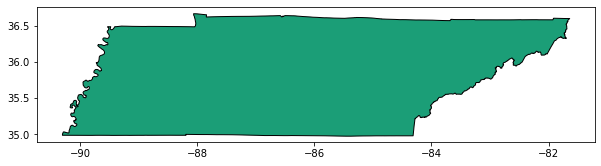

In [20]:
state.plot(column='NAME', figsize=(10, 10),
              edgecolor = 'black', cmap='Dark2');

In [21]:
points = []
for idx, row in hub_covid_violations_geocodio_df.iterrows():
    #split by new lines get last split, replace any parens, split on commas
#     position = row.split('\n')[-1].replace('(', '').replace(')', '').split(',')
    try:
        # Build a point if we can
        points.append(Point(row['Latitude_geocodio'], row['Longitude_geocodio']))
    except Exception as exc_info: 
        print(exc_info)
        # If we can't build a point, put a null
        points.append(np.NaN)

In [22]:
hub_covid_violations_geocodio_df['position'] = points

In [23]:
hub_covid_violations_geocodio_geodf = gpd.GeoDataFrame(hub_covid_violations_geocodio_df, crs=state.crs, geometry=hub_covid_violations_geocodio_df['position'])

In [24]:
hub_covid_violations_geocodio_geodf.T

,0,1,2,3,4,5,6,7,8,9,...,11708,11709,11710,11711,11712,11713,11714,11715,11716,11717
Request #,444823,479965,392927,444512,444440,339424,348304,429011,444154,479306,...,496913,497068,497060,497094,497139,497610,497019,497616,497255,497449
Status,Closed,Closed,Closed,Closed,Closed,Closed,Closed,Closed,Closed,Closed,...,Assigned,New,Assigned,New,New,New,New,New,Assigned,Assigned
Date / Time Opened,2020-08-14 02:38:00,2020-10-13 11:48:40,2020-06-16 00:35:20,2020-08-13 18:50:31,2020-08-13 18:03:09,2020-04-04 20:18:05,2020-04-17 21:30:20,2020-07-28 14:17:21,2020-08-13 15:17:51,2020-10-12 13:08:11,...,2020-11-06 15:24:56,2020-11-06 17:21:18,2020-11-06 17:15:16,2020-11-06 17:35:02,2020-11-06 18:08:16,2020-11-07 01:46:57,2020-11-06 16:43:39,2020-11-07 02:25:00,2020-11-06 19:19:25,2020-11-06 21:39:27
Date / Time Closed,2020-08-14 14:37:15,2020-10-13 13:48:08,2020-06-17 14:28:19,2020-08-14 14:22:11,2020-08-14 14:18:59,2020-04-09 14:20:19,2020-04-21 14:07:48,2020-07-29 15:52:58,2020-08-14 14:08:07,2020-10-13 13:22:40,...,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
Contact Type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
State Issue,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Closed When Created,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Address,2045 Antioch Pike,2800 Opryland Dr,2607 12th Ave S,3200 Clarksville Pike,20 Grundy St,800 Main St,130 LifeWay Plaza,3131 Dickerson Rd,651 Thompson Ln,401 7th Ave N,...,657 Massman Dr,306 North Gallatin Pike N,3805 Park Ave,249 Blanton Ave,1124 Murfreesboro Rd,3696 Bell Rd,5106 Old Hickory Blvd,8027 E Lamar Alexander Pkwy,440 McMurray Dr,3706 Hillsboro Pike
City,ANTIOCH,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,NASHVILLE,...,NASHVILLE,MADISON,NASHVILLE,NASHVILLE,NaN,NASHVILLE,NASHVILLE,NaN,NASHVILLE,NASHVILLE
Council District,28,15,18,2,19,6,19,8,16,19,...,15,9,24,17,NaN,13,1,NaN,27,25


In [25]:
gpd.sjoin(hub_covid_violations_geocodio_geodf, state, op='within')

,Request #,Status,Date / Time Opened,Date / Time Closed,Contact Type,State Issue,Closed When Created,Address,City,Council District,...,index_right,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER


### Timeline Heatmap Animation

In [26]:
data_points = []
for idx, row in hub_covid_violations_geocodio_df.sort_values('Date / Time Opened').iterrows():
    if row['geometry'] and not pd.isna(row['geometry'].x) and not pd.isna(row['geometry'].y):
        data_points.append((row['Date / Time Opened'].to_pydatetime(), row['geometry'].x, row['geometry'].y))


by_day=defaultdict(list)
for record in data_points:
    by_day[f'{record[0].strftime("%Y-%m-%d")}'].append([record[1],record[2], 1])
    
over_time = []
time_index = []
for key, values in by_day.items():
    over_time.append(values)
    time_index.append(key)

In [27]:
time_index

['2020-03-29',
 '2020-03-30',
 '2020-03-31',
 '2020-04-01',
 '2020-04-02',
 '2020-04-03',
 '2020-04-04',
 '2020-04-05',
 '2020-04-06',
 '2020-04-07',
 '2020-04-08',
 '2020-04-09',
 '2020-04-10',
 '2020-04-11',
 '2020-04-12',
 '2020-04-13',
 '2020-04-14',
 '2020-04-15',
 '2020-04-16',
 '2020-04-17',
 '2020-04-18',
 '2020-04-19',
 '2020-04-20',
 '2020-04-21',
 '2020-04-22',
 '2020-04-23',
 '2020-04-24',
 '2020-04-25',
 '2020-04-26',
 '2020-04-27',
 '2020-04-28',
 '2020-04-29',
 '2020-04-30',
 '2020-05-01',
 '2020-05-02',
 '2020-05-03',
 '2020-05-04',
 '2020-05-05',
 '2020-05-06',
 '2020-05-07',
 '2020-05-08',
 '2020-05-09',
 '2020-05-10',
 '2020-05-11',
 '2020-05-12',
 '2020-05-13',
 '2020-05-14',
 '2020-05-15',
 '2020-05-16',
 '2020-05-17',
 '2020-05-18',
 '2020-05-19',
 '2020-05-20',
 '2020-05-21',
 '2020-05-22',
 '2020-05-23',
 '2020-05-24',
 '2020-05-25',
 '2020-05-26',
 '2020-05-27',
 '2020-05-28',
 '2020-05-29',
 '2020-05-30',
 '2020-05-31',
 '2020-06-01',
 '2020-06-02',
 '2020-06-

In [28]:
mapheattime = folium.Map(zoom_start=11, location=[36.16784,-86.77816])
hm = HeatMapWithTime(data=over_time,
    index=time_index,
    auto_play=False,
    max_opacity=0.3,
    )
hm.add_to(mapheattime)
mapheattime

In [35]:
mapheattime.save('../slide-exports/violations_visualized_per_day.html')